# Singapore Weather Time Series Analysis

## Exploratory Data Analysis (EDA) Notebook

### **Project: Rainfall Forecasting Pipeline**

**Name:** Brian Isaac Kam  
**Email:** isaacbikjk@gmail.com

---

### **Objective**

This notebook serves as the **Exploratory Data Analysis (EDA)** component of the end-to-end machine learning pipeline for **forecasting Singapore's average rainfall amount**. The primary goals of this EDA are to:

1. **Fetch historical weather data** (e.g., air temperature) from Singapore's public weather API for a relevant period.
2. **Visualise the time series data**, plotting temperature against time to understand temporal patterns.
3. **Analyse the data** for:
   - **Trends:** Long-term directional movement.
   - **Seasonality:** Recurring daily or weekly patterns.
   - **Cycles:** Longer-term cyclical variations.
   - **Stationarity:** Statistical properties consistency over time.
4. **Inspect for missing values and outliers**, and if using multiple stations
5. **Perform time series decomposition** to separate trend, seasonality, and residual components.

---

### **Importance of this EDA**

The insights derived here will guide **feature engineering and model selection** in subsequent stages, informing decisions such as:

- The need for **differencing to achieve stationarity**.
- **Seasonal adjustments** to capture periodic effects.
- Selection of **appropriate forecasting models** (e.g., ARIMA for stationary data, LSTM/Transformer for sequential learning).

---


#### **Fetching Historical Weather Data**

In [1]:
# automatically reloads python modules
%load_ext autoreload
%autoreload 2

In [ ]:
# import custom function
from src.data_preprocessor import download_datasets_by_type

# download historical rainfall data
download_datasets_by_type(collection_id=2279, data_type="rainfall")


#### **Aggregating & Preparing Dataset**

In [ ]:
# import custom class
from src.data_preprocessor import DataPreparation

# instantiate dataprep class
dataprep = DataPreparation(folder_path='./data/rainfall')

# aggregate mean rainfall reading
df_agg = dataprep.aggregate_mean_by_hour()

df_agg

/home/brian-isaac/Documents/all-assignments/assignment6/A6P4_Hands-on-Project-Repository/src/data_preprocessor.py:135: FutureWarning: 'H' is deprecated and will be removed in a future version, please use 'h' instead.
  hourly = ts_mean.resample('H').mean()


,reading_value_hourly_mean
timestamp,
2016-12-02 21:00:00+08:00,0.000000
2016-12-02 22:00:00+08:00,0.000000
2016-12-02 23:00:00+08:00,0.000000
2016-12-03 00:00:00+08:00,0.000000
2016-12-03 01:00:00+08:00,0.040370
...,...
2024-12-31 19:00:00+08:00,0.007701
2024-12-31 20:00:00+08:00,0.000525
2024-12-31 21:00:00+08:00,0.000000


In [ ]:
# Save result for easier loading in the future
df_agg.to_csv("./data/aggregated/rainfall.csv", index=True)

In [2]:
# Load if saved
import pandas as pd
df_agg = pd.read_csv('./data/aggregated/rainfall.csv', index_col='timestamp')
df_agg.index = pd.to_datetime(df_agg.index)
df_agg

,reading_value_hourly_mean
timestamp,
2016-12-02 21:00:00+08:00,0.000000
2016-12-02 22:00:00+08:00,0.000000
2016-12-02 23:00:00+08:00,0.000000
2016-12-03 00:00:00+08:00,0.000000
2016-12-03 01:00:00+08:00,0.040370
...,...
2024-12-31 19:00:00+08:00,0.007701
2024-12-31 20:00:00+08:00,0.000525
2024-12-31 21:00:00+08:00,0.000000


#### **<u>Missingness Checks</u>**
Missingness checks are essential for ensuring data quality and integrity: by quantifying and visualising gaps in your dataset, you can detect whether missing values occur at random or follow a pattern (e.g. time-of-day effects), assess the potential bias they introduce, and choose the right handling strategy—such as imputation, interpolation, or deletion—to preserve the validity and reliability of your analyses and models. 

The following missingness checks will be done:
- **Missingness Summary**  

We compute, for each column, the total number and percentage of missing values. This gives a quick, quantitative overview of where data gaps are most severe and helps prioritise which variables need attention first.

- **Visualisation**  

For a univariate time series, we plot the measured values over time and explicitly mark any missing timestamps. For multivariate data, we use a heat-map (matrix) and bar chart to reveal patterns of co-missingness across columns. Visualising missingness makes it easy to spot systematic gaps (e.g. blocks of time with no data) or columns that persistently lose values.

- **Little’s MCAR Test**  

When there are at least two numeric variables, we run Little’s test to assess whether the missing values are “Missing Completely At Random” (MCAR). A non-significant result (p > 0.05) supports the assumption of MCAR—meaning simple imputation or row-deletion won’t bias analyses—whereas a significant result suggests that missingness may depend on observed or unobserved data and calls for more sophisticated handling.

In [4]:
# import custom function
from src.data_preprocessor import missingness_report

missingness_report(df_agg)

Missingness Summary:
                           missing_count  missing_pct
reading_value_hourly_mean           2807         3.96


MCAR test requires at least two numeric columns; skipping.


,missing_count,missing_pct
reading_value_hourly_mean,2807,3.96


#### **<u>Interpretation</u>**
The time-series has 2807 missing hourly values, about 3.96 % of all observations. The red × markers are scattered—no huge contiguous block—which suggests no long outages but rather occasional individual hours.

#### **Next-Steps**
Prepare the dataset for the following models:
#### **<u>Univariate Forecasting</u>**:
**ARIMA/SARIMA**
- **Data Prep:**  
  - Ensure **complete hourly grid** (impute gaps).  
  - Check stationarity (ADF/KPSS tests) and apply non-seasonal (`d`) and seasonal (`D`) differencing.  
  - Use ACF/PACF plots to identify candidate `(p,d,q)` and `(P,D,Q,s)` settings.  
- **Implementation:**  
  - `statsmodels.tsa.statespace.SARIMAX` for SARIMA.  
  - Grid-search hyperparameters via AIC/BIC.

**Prophet**
- **Data Prep:**  
  - Single time-series with columns `ds` (timestamp) and `y` (rainfall).  
  - Impute missing hours (Prophet can handle some gaps, but regular spacing is best).  
- **Implementation:**  
  - `fbprophet` (or `prophet` package)  
  - Specify daily and weekly seasonality and any special event/holiday regressors.

#### **<u>Multivariate Models</u>**:
**Time-Aware LSTM**
- **Data Prep:**  
  - **Features:**  
    - `rainfall_t−k` lag features (e.g. last 24 h).  
    - Rolling statistics (mean, std over 6 h, 24 h).  
    - **Elapsed time** since last measurement (in hours).  
    - Optional calendar embeddings (hour of day, day of week).  
  - **Sequences:** sliding windows of length `L` (e.g. 168 h) → horizon `H` (e.g. next 24 h).  
  - Scale features (e.g. MinMax or Standard).  
- **Implementation:**  
  - Custom PyTorch/Keras LSTM cell with an extra input for elapsed time.  
  - Mask or impute missing steps inside the sequences.

**Transformer-Based Models**
- **Data Prep:**  
  - **Positional encodings** for timestamp (sinusoidal or learned for hour/day).  
  - Static covariates (e.g. station metadata) if using multi-station data.  
  - Dynamic covariates (lags, rolling stats, calendar features).  
  - Input: sliding windows of fixed length.  
- **Implementation Options:**  
  - **Temporal Fusion Transformer (TFT):** Integrates static, known future, and observed past covariates with interpretable attention.  
  - **Informer / Autoformer:** Efficient for very long sequences.  
  - Use libraries like PyTorch Forecasting or Hugging Face’s `transformers` with time-series extensions.


#### **<u>Univariate Forecasting EDA</u>**
For the purposes of EDA we would be imputing the dataset before splitting. However, in the data processing pipeline we would split the dataset before imputing to prevent data leakages.

**<u>Imputing Missing Values</u>**

The following two methods were implemented, they were taken into consideration to prevent data leakages in time-series
- **Forward‐Fill (`ffill`)**  
Carries the last observed value forward into any subsequent missing timestamps. This simple, causal method ensures that only past information is used—no future data ever “leaks” into the imputation. It’s best when you believe the value remains constant until a new observation arrives.

- **Rolling Mean (`rolling_mean`)**  
Replaces each missing point with the average of the previous observations over a specified time window (e.g. the past 24 hours). Because the rolling calculation only looks backward, it maintains causality and avoids leakage, while smoothing out short‐term fluctuations.  

In [3]:
# import custom functions
from src.data_preprocessor import causal_impute

# perform forward filling
df_ffill = causal_impute(df_agg, "reading_value_hourly_mean", method="ffill")
df_ffill

/home/brian-isaac/Documents/all-assignments/assignment6/A6P4_Hands-on-Project-Repository/src/data_preprocessor.py:199: FutureWarning: Series.fillna with 'method' is deprecated and will raise in a future version. Use obj.ffill() or obj.bfill() instead.
  df_imputed[value_col] = series.fillna(method="ffill")


,reading_value_hourly_mean
timestamp,
2016-12-02 21:00:00+08:00,0.000000
2016-12-02 22:00:00+08:00,0.000000
2016-12-02 23:00:00+08:00,0.000000
2016-12-03 00:00:00+08:00,0.000000
2016-12-03 01:00:00+08:00,0.040370
...,...
2024-12-31 19:00:00+08:00,0.007701
2024-12-31 20:00:00+08:00,0.000525
2024-12-31 21:00:00+08:00,0.000000


In [5]:
missingness_report(df_ffill)

Missingness Summary:
                           missing_count  missing_pct
reading_value_hourly_mean              0          0.0


MCAR test requires at least two numeric columns; skipping.


,missing_count,missing_pct
reading_value_hourly_mean,0,0.0


**<u>Stationarity, ACF, PACF</u>**

>>> Augmented Dickey-Fuller Test
ADF Statistic: -29.8379
p-value: 0.0000
Critical Values:
  1%: -3.4304
  5%: -2.8616
  10%: -2.5668

>>> KPSS Test
KPSS Statistic: 0.4299
p-value: 0.0643
Critical Values:
  10%: 0.3470
  5%: 0.4630
  2.5%: 0.5740
  1%: 0.7390


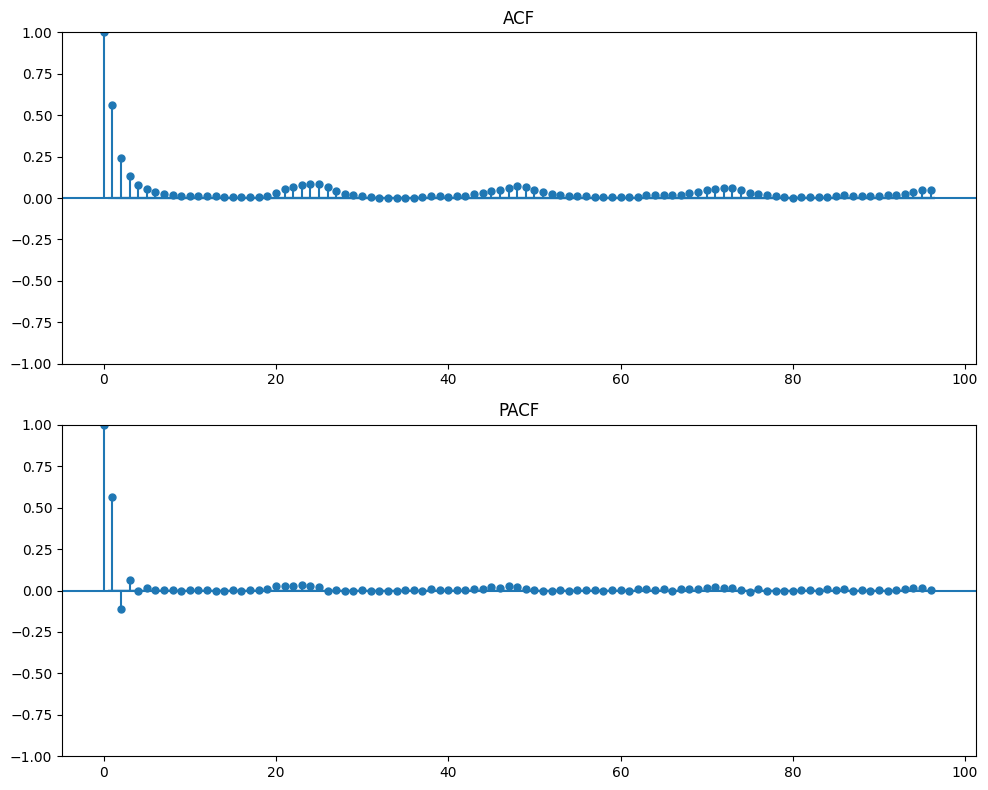

In [18]:
# import custom class
from src.data_preprocessor import UnivariateEDA

# instantiate eda class
unieda = UnivariateEDA(df_ffill)

# check stationarity on the differenced series
eda_sd = UnivariateEDA(df_ffill, seasonal_period=None)  
eda_sd.check_stationarity()

# plot the acf/pacf 
eda_sd.plot_acf_pacf(lags=96)

**<u>Interpretation</u>**

From the ACF and PACF plots we can see the following:
- ACF Plot: The ACF plot shows a minor sinusoidal pattern with a periodicity, indicating strong seasonal behaviour every 24 hrs (daily seasonality), the quick decay in autocorrelation suggests a stationary series with minor seasonality.
- PACF Plot: The PACF plot shows significant spikes at lag 1, 2 and 3, indicating that these lags are important in modeling the underlying data.

The ADF statistic (–29.84) is far below all critical values, and the p-value is essentially zero.  
> **Conclusion**: reject the null of non-stationarity; the raw series behaves like a stationary process.

The KPSS statistic (0.4299) is below the 5% critical value (0.463) but above the 10% threshold (0.347), yielding a p-value of about 0.06.  
> **Conclusion**: fail to reject the null of stationarity at the 5% level (though it’s borderline at 10%), so there’s no strong evidence of a unit root.

Both tests agree that the undifferenced series shows no persistent trend or unit‐root behavior. In other words, **no additional non-seasonal differencing (\(d=0\)) is needed**.

We will now plot ACF/PACF plots with seasonal period of 24 after applying a seasonal differencing for futher analysis

<string>:37: InterpolationWarning:

The test statistic is outside of the range of p-values available in the
look-up table. The actual p-value is greater than the p-value returned.




>>> Augmented Dickey-Fuller Test
ADF Statistic: -54.8954
p-value: 0.0000
Critical Values:
  1%: -3.4304
  5%: -2.8616
  10%: -2.5668

>>> KPSS Test
KPSS Statistic: 0.0017
p-value: 0.1000
Critical Values:
  10%: 0.3470
  5%: 0.4630
  2.5%: 0.5740
  1%: 0.7390


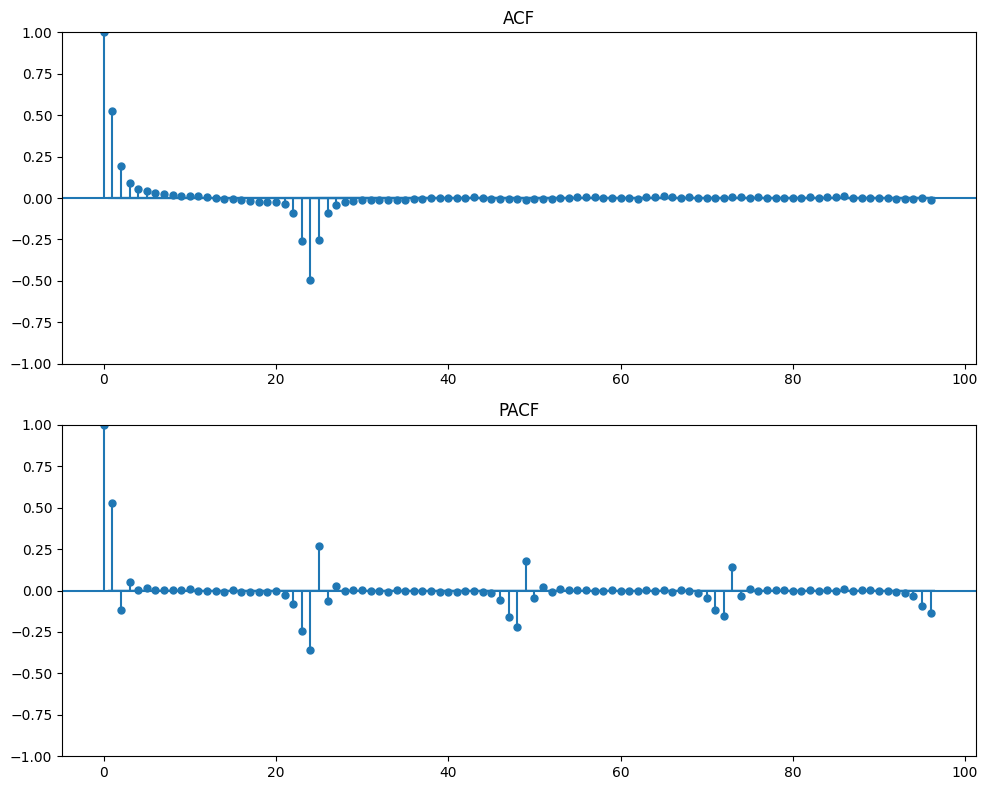

In [ ]:
# instantiate eda class
unieda = UnivariateEDA(df_ffill, seasonal_period=24)

# apply one seasonal difference (D=1), no non-seasonal yet
seasonal_diff = unieda.difference(d=0, D=1)

# check stationarity on the seasonally differenced series
eda_sd = UnivariateEDA(seasonal_diff, seasonal_period=None)  
eda_sd.check_stationarity()

# plot the acf/pacf 
eda_sd.plot_acf_pacf(lags=96)

**<u>Interpretation</u>**

**Stationarity (Seasonal Differencing Only)**

- We applied **one seasonal difference** at lag 24:  
  $$
    y^{(s)}_t = y_t - y_{t-24}
  $$
- **Augmented Dickey–Fuller**: ADF ≈ −54.9, p ≈ 0.00 → reject unit‐root → stationary  
- **KPSS**: KPSS ≈ 0.0017, p = 0.10 → fail to reject stationarity → supports stationarity  
- **Conclusion:** no further non‐seasonal differencing needed ⇒ **\(d = 0\)**

**Non-Seasonal ACF/PACF (on Seasonally-Differenced Series)**

- **ACF**:  
  - Large positive spike at lag 1, then geometric decay  
  - → classical **AR(1)** signature  
- **PACF**:  
  - Significant spike at lag 1, then cuts off  
  - → confirms **p = 1**, **q = 0**

**Seasonal Orders (from Seasonal ACF/PACF)**

- **Seasonal period** \(s = 24\) hours  
- **Seasonal ACF**:  
  - Spike at lag 24 (positive), then near zero at 48, 72…  
  - → **seasonal MA(1)** behavior ⇒ **Q = 1**  
- **Seasonal PACF**:  
  - No significant spike at lag 24  
  - → **P = 0**  
- **Seasonal differencing**: **D = 1**

---

**Final SARIMA Model**

Putting it all together, a good starting specification is:

$$
\boxed{
  \text{SARIMA}\bigl(p=1,\,d=0,\,q=0\bigr)\;\times\;\bigl(P=0,\,D=1,\,Q=1\bigr)_{s=24}
}
$$

- **Non-seasonal** \((p,d,q) = (1,0,0)\)  
- **Seasonal** \((P,D,Q)_s = (0,1,1)_{24}\)


#### **<u>Multivariate Forecasting EDA</u>**
**<u>Preparing Dataset</u>**

Our current dataset only has a univariate feature. The following would be done to collect and concatenate different features.

In [ ]:
# import custom function
from src.data_preprocessor import download_datasets_by_type

# download historical air temperature data
download_datasets_by_type(collection_id=2246, data_type="air_temperature")

# download historical humidity data
download_datasets_by_type(collection_id=2278, data_type="humidity")

# download historical wind direction data
download_datasets_by_type(collection_id=2281, data_type="wind_direction")

# download historical air temperature data
download_datasets_by_type(collection_id=2280, data_type="wind_speed")

Downloaded HistoricalhumidityacrossSingapore2016.csv successfully.
Downloaded HistoricalhumidityacrossSingapore2017.csv successfully.
Downloaded HistoricalhumidityacrossSingapore2018.csv successfully.
Downloaded HistoricalhumidityacrossSingapore2019.csv successfully.
Downloaded HistoricalhumidityacrossSingapore2020.csv successfully.
Downloaded HistoricalhumidityacrossSingapore2021.csv successfully.
Downloaded HistoricalhumidityacrossSingapore2022.csv successfully.
Downloaded HistoricalhumidityacrossSingapore2023.csv successfully.
Downloaded HistoricalhumidityacrossSingapore2024.csv successfully.
Downloaded Historicalwind_directionacrossSingapore2016.csv successfully.
Downloaded Historicalwind_directionacrossSingapore2017.csv successfully.
Downloaded Historicalwind_directionacrossSingapore2018.csv successfully.
Downloaded Historicalwind_directionacrossSingapore2019.csv successfully.
Downloaded Historicalwind_directionacrossSingapore2020.csv successfully.
Downloaded Historicalwind_direct

In [21]:
# import custom class
from src.data_preprocessor import DataPreparation

# instantiate dataprep class
dataprep = DataPreparation(folder_path='./data/air_temperature')

# aggregate mean air_temperature reading
df_agg = dataprep.aggregate_mean_by_hour()

df_agg

/home/brian-isaac/Documents/all-assignments/assignment6/A6P4_Hands-on-Project-Repository/src/data_preprocessor.py:279: FutureWarning:

'H' is deprecated and will be removed in a future version, please use 'h' instead.



,reading_value_hourly_mean
timestamp,
2016-04-15 19:00:00+08:00,29.744113
2016-04-15 20:00:00+08:00,NaN
2016-04-15 21:00:00+08:00,NaN
2016-04-15 22:00:00+08:00,NaN
2016-04-15 23:00:00+08:00,NaN
...,...
2024-12-31 19:00:00+08:00,26.237318
2024-12-31 20:00:00+08:00,26.515599
2024-12-31 21:00:00+08:00,26.586809


In [22]:
# Save result for easier loading in the future
df_agg.to_csv("./data/aggregated/air_temperature.csv", index=True)

In [23]:
# import custom class
from src.data_preprocessor import DataPreparation

# instantiate dataprep class
dataprep = DataPreparation(folder_path='./data/humidity')

# aggregate mean humidity reading
df_agg = dataprep.aggregate_mean_by_hour()

df_agg

,reading_value_hourly_mean
timestamp,
2016-05-17 14:00:00+08:00,68.720000
2016-05-17 15:00:00+08:00,69.007222
2016-05-17 16:00:00+08:00,NaN
2016-05-17 17:00:00+08:00,NaN
2016-05-17 18:00:00+08:00,NaN
...,...
2024-12-31 19:00:00+08:00,90.558712
2024-12-31 20:00:00+08:00,88.654657
2024-12-31 21:00:00+08:00,87.244056


In [24]:
# Save result for easier loading in the future
df_agg.to_csv("./data/aggregated/humidity.csv", index=True)

In [25]:
# import custom class
from src.data_preprocessor import DataPreparation

# instantiate dataprep class
dataprep = DataPreparation(folder_path='./data/wind_direction')

# aggregate mean wind_direction reading
df_agg = dataprep.aggregate_mean_by_hour()

df_agg

,reading_value_hourly_mean
timestamp,
2016-12-01 23:00:00+08:00,293.737530
2016-12-02 00:00:00+08:00,295.797529
2016-12-02 01:00:00+08:00,298.164425
2016-12-02 02:00:00+08:00,274.049541
2016-12-02 03:00:00+08:00,259.819585
...,...
2024-12-31 19:00:00+08:00,133.733500
2024-12-31 20:00:00+08:00,111.944110
2024-12-31 21:00:00+08:00,78.681821


In [26]:
# Save result for easier loading in the future
df_agg.to_csv("./data/aggregated/wind_direction.csv", index=True)

In [27]:
# import custom class
from src.data_preprocessor import DataPreparation

# instantiate dataprep class
dataprep = DataPreparation(folder_path='./data/wind_speed')

# aggregate mean wind_speed reading
df_agg = dataprep.aggregate_mean_by_hour()

df_agg

,reading_value_hourly_mean
timestamp,
2016-12-08 11:00:00+08:00,4.785324
2016-12-08 12:00:00+08:00,5.133484
2016-12-08 13:00:00+08:00,5.694370
2016-12-08 14:00:00+08:00,6.354957
2016-12-08 15:00:00+08:00,6.490887
...,...
2024-12-31 19:00:00+08:00,2.611870
2024-12-31 20:00:00+08:00,3.177178
2024-12-31 21:00:00+08:00,3.863304


In [28]:
# Save result for easier loading in the future
df_agg.to_csv("./data/aggregated/wind_speed.csv", index=True)

#### **Clean Data Folder**
We will be clearing all raw datasets saved in each folder to reduce disk space usage. (~40gb)

In [ ]:
import os
import shutil

data_dir = './data'

for entry in os.listdir(data_dir):
    if entry == 'aggregated':
        continue
    full_path = os.path.join(data_dir, entry)
    try:
        if os.path.isdir(full_path):
            shutil.rmtree(full_path)
        else:
            os.remove(full_path)
        print(f"Removed: {full_path}")
    except Exception as e:
        print(f"Could not remove {full_path}: {e}")

Removed: ./data/air_temperature
Removed: ./data/wind_speed
Removed: ./data/rainfall
Removed: ./data/wind_direction
Removed: ./data/humidity


In [6]:
from src.data_preprocessor import load_and_merge_dfs

merged = load_and_merge_dfs("data/aggregated")
merged

,wind_speed,air_temperature,wind_direction,humidity,rainfall
timestamp,,,,,
2016-04-15 19:00:00+08:00,NaN,29.744113,NaN,NaN,NaN
2016-04-15 20:00:00+08:00,NaN,NaN,NaN,NaN,NaN
2016-04-15 21:00:00+08:00,NaN,NaN,NaN,NaN,NaN
2016-04-15 22:00:00+08:00,NaN,NaN,NaN,NaN,NaN
2016-04-15 23:00:00+08:00,NaN,NaN,NaN,NaN,NaN
...,...,...,...,...,...
2024-12-31 19:00:00+08:00,2.611870,26.237318,133.733500,90.558712,0.007701
2024-12-31 20:00:00+08:00,3.177178,26.515599,111.944110,88.654657,0.000525
2024-12-31 21:00:00+08:00,3.863304,26.586809,78.681821,87.244056,0.000000


#### **<u>Missingness Checks</u>**
Same with the univariate dataset we would be checking for missingness relations.

In [7]:
# import custom function
from src.data_preprocessor import missingness_report

missingness_report(merged)

Missingness Summary:
                 missing_count  missing_pct
rainfall                  8353        10.94
wind_speed                7501         9.82
wind_direction            7003         9.17
humidity                  3482         4.56
air_temperature           2146         2.81


Little's MCAR test p-value = 0.000
Little's test: data may not be MCAR (reject H0).


,missing_count,missing_pct
rainfall,8353,10.94
wind_speed,7501,9.82
wind_direction,7003,9.17
humidity,3482,4.56
air_temperature,2146,2.81


#### **<u>Interpretation</u>**
For the multivariate time-series missingness, there is 10.94% max missing values which could be introduced due to new datapoints when doing a full outer join. 

It is observed that 2016 dataset is incomplete for most of the features and hence not using it might be beneficial.

With Little’s test p-value effectively zero (p < 0.001), we reject MCAR: missingness isn’t completely random. It’s structurally tied to time (the early period) and to the type of measurement (rainfall/wind vs. temperature/humidity). This points toward a Missing at Random (MAR) mechanism, where gaps depend on observed covariates (e.g., date or sensor type).

#### **<u>Multivariate Forecasting EDA</u>**
For the purposes of EDA we would be imputing the dataset before splitting. However, in the data processing pipeline we would split the dataset before imputing to prevent data leakages.

**<u>Imputing Missing Values</u>**

The following two methods were implemented, they were taken into consideration to prevent data leakages in time-series
- **Forward‐Fill (`ffill`)**  
  Carries the last observed value forward into any subsequent missing timestamps. This causal approach uses only past data—no future observations ever leak into the series. Ideal when you expect measurements to remain constant until the next recording.

- **Rolling Mean (`rolling_mean`)**  
  For each timestamp, fills a missing value with the mean of the previous _N_ observations (e.g. past 24 hours). Because it only looks backward in time, it preserves causality while smoothing short-term noise.

- **Constant Fill (`constant`)**  
  Replaces all missing entries with a user-specified fixed value (e.g. zero). Simple and leakage-free, it’s useful when you have a domain-driven “default” level.

In [12]:
# import custom functions
from src.data_preprocessor import clean_multivariate

# perform forward filling
cleaned, (start, end) = clean_multivariate(merged)
print(f"Dropped initial window from {start} to {end}")

Dropped initial window from 2017-01-01 00:00:00+08:00 to 2017-01-01 07:00:00+08:00


In [11]:
cleaned

,wind_speed,air_temperature,wind_direction,humidity,rainfall
timestamp,,,,,
2017-01-01 08:00:00+08:00,4.137024,26.331060,304.718564,88.912444,0.000000
2017-01-01 09:00:00+08:00,4.395024,27.469962,186.142660,85.200087,0.000000
2017-01-01 10:00:00+08:00,6.279006,28.676770,45.607390,78.921134,0.000000
2017-01-01 11:00:00+08:00,7.147096,29.745027,55.999169,73.289715,0.000000
2017-01-01 12:00:00+08:00,7.142076,30.039150,65.628411,70.887591,0.008052
...,...,...,...,...,...
2024-12-31 19:00:00+08:00,2.611870,26.237318,133.733500,90.558712,0.007701
2024-12-31 20:00:00+08:00,3.177178,26.515599,111.944110,88.654657,0.000525
2024-12-31 21:00:00+08:00,3.863304,26.586809,78.681821,87.244056,0.000000


We will instantiate a multivariate eda class that takes in our cleaned dataframe and creates a target column (rainfall shifted up) and do the following methods for analysis:
- Correlation Heatmap

Show the strength of linear relationships among all predictors and the 1-hour-ahead rainfall target using a heatmap of correlation coefficients.

- Pairwise Scatter & Marginal Plots

Visualise pairwise scatterplots with marginal histograms to uncover non-linear patterns, clusters, and outliers.

- Cross-Correlation Analysis

Compute correlations at multiple time lags between each predictor and the 1-hour-ahead rainfall to identify which lag carries the strongest signal.


**<u>Correlation Heatmap</u>**

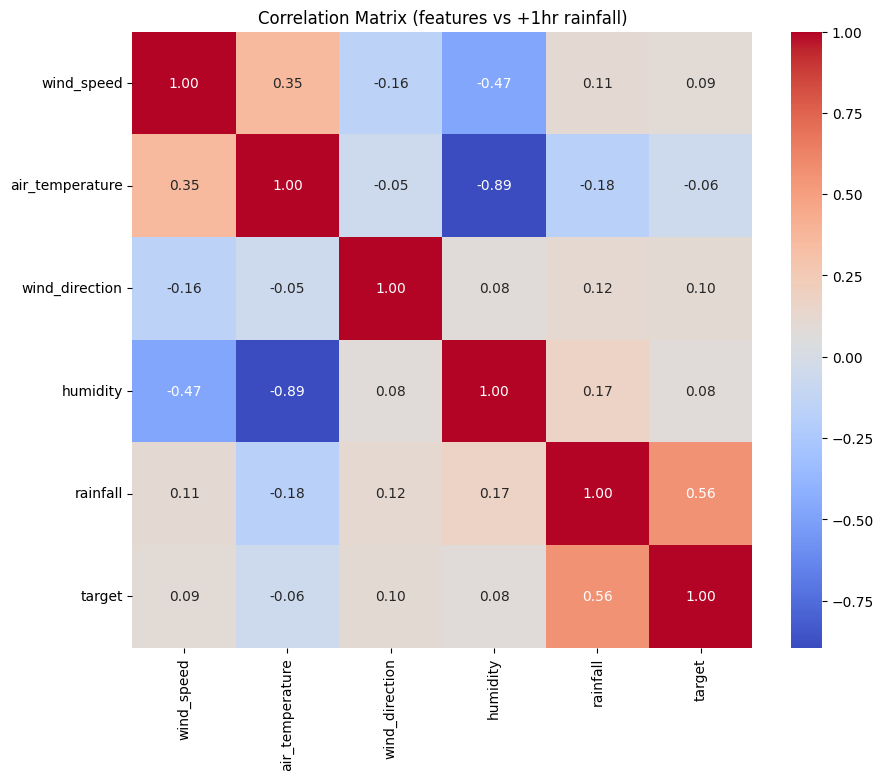

In [14]:
# import custom class
from src.data_preprocessor import MultivariateEDA

# instantiate the class
multieda = MultivariateEDA(cleaned, target_col='rainfall')

# heatmap
multieda.correlation_heatmap()

**<u>Pairwise Scatter & Marginal Plots</u>**

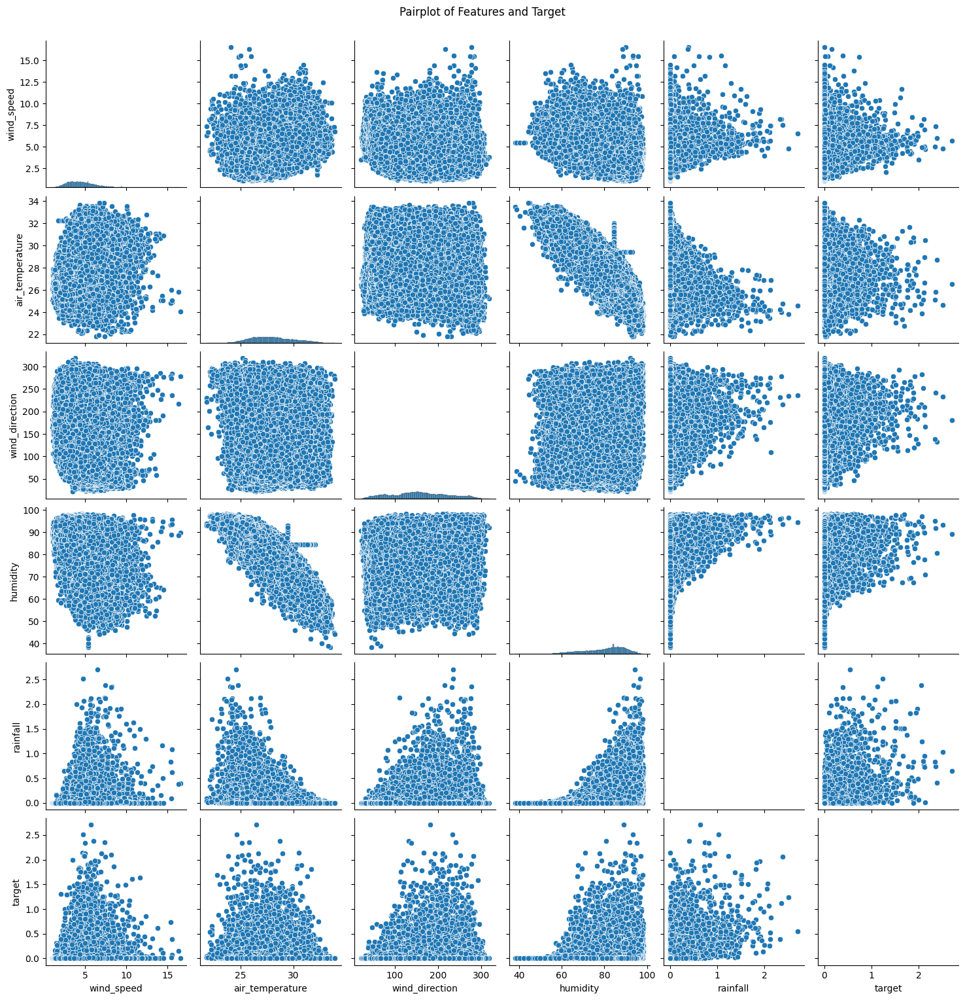

In [15]:
multieda.pairplot()

**<u>Cross-Correlation Analysis</u>**

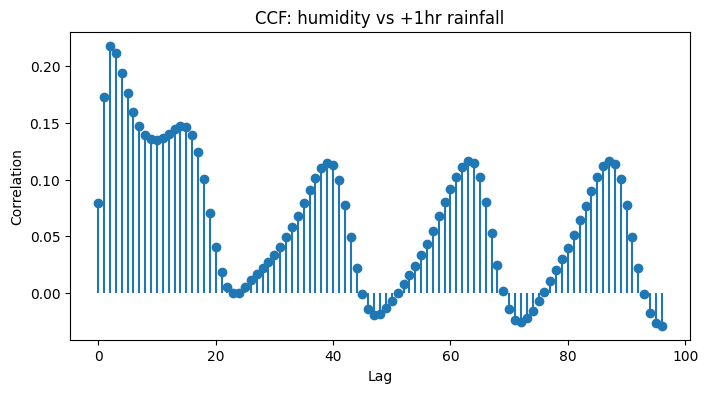

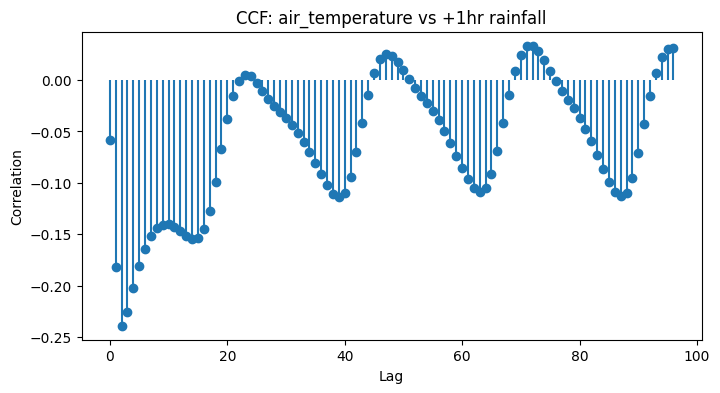

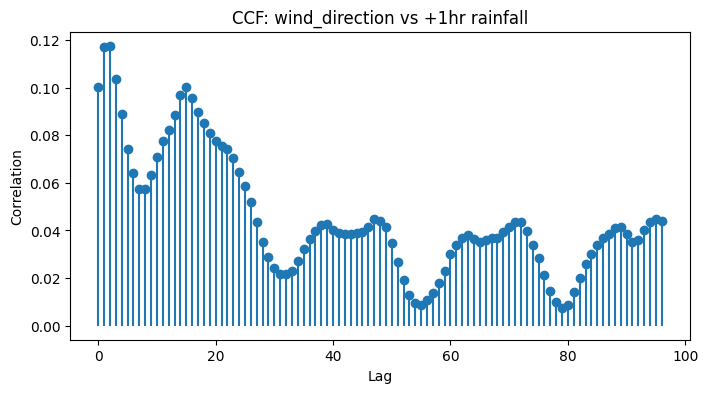

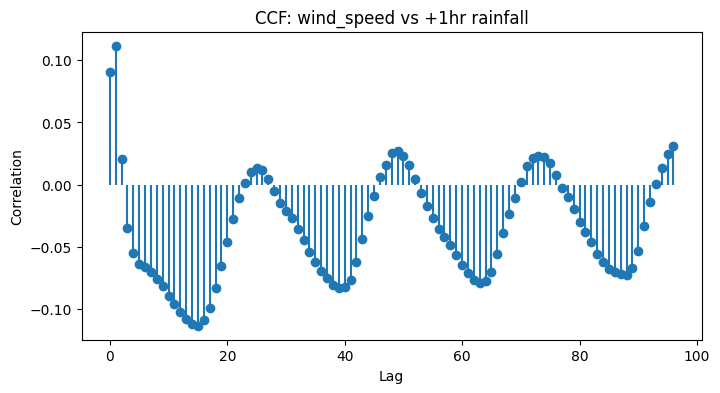

In [19]:
multieda.cross_correlation('humidity', max_lag=96)
multieda.cross_correlation('air_temperature', max_lag=96)
multieda.cross_correlation('wind_direction', max_lag=96)
multieda.cross_correlation('wind_speed', max_lag=96)

**<u>Interpretation</u>**

**Correlation Heatmap**  
- **Rainfall ↔ Target (r≈0.56)**: Past‐hour rainfall has a strong positive linear relationship with the next‐hour rainfall, confirming it’s a key predictor.  
- **Humidity ↔ Air Temperature (r≈–0.89)**: Very strong inverse link—warmer hours tend to be drier, cooler hours more humid.  
- **Wind Speed ↔ Humidity (r≈–0.47)**: Moderate negative correlation, suggesting gusty periods coincide with lower humidity.  
- Other feature correlations are weak to moderate (|r|<0.3), hinting at mostly independent signals or non‐linear relationships.

---

**Pairwise Scatter & Marginal Plots**  
- **Rainfall vs. Target**: A clear upward trend with lots of zero‐rain points—many no‐rain hours, a long right tail for heavier events.  
- **Humidity vs. Target**: Higher humidity generally precedes rain, but with broad scatter—points to a non‐perfect but useful signal.  
- **Air Temperature vs. Target**: Cooler temperatures slightly favor rain, but the cloud is diffuse—likely non‐linear.  
- **Wind Features**: No obvious single‐line patterns, but clusters and spread suggest regimes (e.g., calm vs. windy rains).

---

**Cross-Correlation Patterns**  
All four series show **repeating peaks every ~24 hours**, plus a strong immediate (lag 0–1) effect:

- **Humidity**  
  - Sharp peak at lag 0–1 hr, then oscillations with 24 hr periodicity.  
  - Implies both an immediate humidity boost before rain and a diurnal cycle.

- **Air Temperature**  
  - Negative correlation strongest at lag 0–5 hrs, then 24 hr cycles of weaker oscillations.  
  - Suggests cooler periods just before rain, on both daily and multi‐day rhythms.

- **Wind Direction**  
  - Smaller peak at lag 0–2 hrs, plus gentle 24 hr oscillations.  
  - Means wind shifts just before rain, with a daily rhythm (perhaps sea‐breeze effects).

- **Wind Speed**  
  - Immediate positive tick at lag 0, then a negative trough around lag 10–15 hrs, and clear 24 hr cycles thereafter.  
  - Indicates a brief speed‐up before rain, then lull, repeating daily.

---

**Implications for Lookback Window**  
- **24-Hour Periodicity**: Every feature’s cross-correlation peaks and troughs recur on a ~24 hr cycle.  
- **Lookback Choice**: To capture both the immediate pre-rain signal **and** the diurnal context, use a lookback window of at least **24 hours** (or multiples thereof) when featurizing for TLSTM or Transformer models.


---

## EDA Notebook Summary

### 1. Univariate Rainfall Series  
- **Seasonal Differencing only**  
  - Applied one seasonal difference at lag 24:  
    $$
      y^{(s)}_t = y_t - y_{t-24}
    $$
  - **Stationarity tests**:  
    - ADF ≈ –54.9 (p≈0.00) → reject unit root  
    - KPSS ≈0.0017 (p=0.10) → fail to reject stationarity  
  - **Conclusion**: no further non-seasonal differencing needed (d=0).

- **ACF/PACF on Seasonally-Differenced Series**  
  - ACF: large spike at lag 1 + geometric decay → AR(1)  
  - PACF: significant at lag 1 then cuts off → p=1, q=0  

- **Seasonal Orders (s=24)**  
  - Seasonal ACF: spike at 24 → MA(1) ⇒ Q=1  
  - Seasonal PACF: no spike at 24 ⇒ P=0  
  - Seasonal differencing D=1  

- **Final SARIMA**  
  $$
    \text{SARIMA}(p,d,q)\,\times\,(P,D,Q)_{s} \;=\; (1,0,0)\,\times\,(0,1,1)_{24}
  $$

---

### 2. Multivariate Feature Exploration  
- **Correlation Heatmap**  
  - Rainfallₜ ↔ Rainfallₜ₊₁: r≈0.56 (strong predictor)  
  - Humidity ↔ Air Temp: r≈–0.89 (very strong inverse)  
  - Wind Speed ↔ Humidity: r≈–0.47 (moderate negative)  
  - Other inter-feature correlations are weak (|r|<0.3).

- **Pairwise Scatter & Marginals**  
  - Rainfall vs. Target: heavy mass at zero + right-skewed tail  
  - Humidity: higher values tend to precede rain, but with scatter  
  - Air Temp: cooler temps slightly favor rain (diffuse)  
  - Wind features: no clear linear trends, suggest weather “regimes.”

- **Cross-Correlation Patterns**  
  - Every predictor shows a strong lag 0–1 signal plus recurring 24-hr peaks/troughs.  
  - Humidity: immediate boost pre-rain + diurnal cycle  
  - Temperature: negative pre-rain effect + daily oscillations  
  - Wind Direction/Speed: brief pre-rain shifts followed by 24-hr rhythms  

- **Lookback Window Implication**  
  The clear 24-hour periodicity in every feature’s cross-correlations suggests using at least a **24-hour lookback** (or multiples) to capture both the immediate pre-rain signal and the diurnal context for TLSTM/Transformer models.

---

### 3. Key Takeaways  
- **Univariate SARIMA** for benchmarking: (1,0,0)×(0,1,1)\[_24_\].  
- **Multivariate inputs**: include past 24 hrs of rainfall along with humidity, temperature, wind direction & speed.  
- **Feature engineering**: focus on lag 0–1 and diurnal (24 hr) lags, and consider transformations for non-linear effects.  
- **Model pipeline**: use a 24 hr lookback window, handle seasonality via embedding or periodic encodings, and compare against the SARIMA baseline.
